<div style="
    font-family: 'Courier New', monospace; 
    font-size: 24px; 
    font-weight: bold; 
    text-align: center; 
    color: #FFD700; /* Gold text */
    background-color: #1E1E1E; /* Dark gray background */
    padding: 20px; 
    border: 2px solid #FFD700; 
    border-radius: 15px; 
    box-shadow: 0 4px 6px rgba(255, 215, 0, 0.3);">
    ⚡ Ecomatrix | Nano Banana ⚡


# Overview  

This notebook demonstrates the workflow of **EcoMatrix**, an AI-powered comic generation tool designed to make environmental storytelling engaging and accessible.  

The **problem context** is the growing need to communicate climate solutions in a way that is creative, hopeful, and visually compelling.  
The **intended outcome** is to empower users—regardless of artistic skill—to create professional-looking comics that transform abstract environmental challenges into inspiring narratives.

## What is *NanoBanana* used for here?  
**NanoBanana** (*Gemini 2.5 Flash Image Preview*) is the image-editing and inpainting engine within EcoMatrix.  

- It powers the **“Edit with words”** workflow: users can refine their comics through natural language prompts (e.g., *“make the scene rainy”* or *“add a friendly sun wearing sunglasses”*).  
- It is also used to **apply comic-book styling** to raw AI-generated images.  
- Additionally, it supports **post-generation edits** with quick effects or custom text commands.  


## What does *EcoMatrix* represent?  
**EcoMatrix** is the overall application — a React + TypeScript single-page app that integrates Google Gemini APIs to generate comics.  

It represents an **interactive storytelling studio** where users can:  
- Create comics with AI-generated art.  
- Style and edit images dynamically.  
- Export and share their final stories.  

A key innovation is the **“User-as-Hero”** feature, which integrates a person’s likeness into comic characters using multimodal AI.  


  








## Key Inputs and Outputs  

### Inputs:  
- A **text prompt** (story idea)  
- Optional **voice input** (via Web Speech API)  
- Optional **character definitions** (names, powers, traits)  
- Optional **photo upload** for the *“User-as-Hero”* feature  
- **Editing commands** (quick effects or free-form text edits)  

### Outputs:  
- A **4-panel comic strip** (single stylized image)  
- Or a **3-page narrative comic** (multi-image sequence)  
- **Stylized images** transformed into comic art (e.g., Manga, Western Comics)  
- **Editable comic pages** with narration support (text-to-speech)  
- **Export options:** PNG, vertical webcomic, or PDF  

# **EcoMatrix: AI Comic Creator**
**Tech:** Gemini 2.5 Flash Image Preview (aka *Nano Banana*), Gemini 2.5 Flash (text), ElevenLabs TTS, fal.ai (FLUX)  
**Goal:** Create climate-positive comics with **consistent characters**, **prompt-based edits**, and **voice narration**.

👉 **Try EcoMatrix App Here:**  
[https://aistudio.google.com/apps/drive/1foXSjzeyzKSOlYVHjhBA-7M7QhYaCGDG](https://aistudio.google.com/apps/drive/1foXSjzeyzKSOlYVHjhBA-7M7QhYaCGDG)
##### 🎬 Watch the Demo
[![EcoMatrix Demo](https://img.youtube.com/vi/YfdwZUSirEU/0.jpg)](https://youtu.be/YfdwZUSirEU)

<a id="toc"></a>
<div style="text-align:center; border-radius:30px 30px; padding:7px; color:white; font-size:110%; font-family:Arial; background-color:#5b81d4;">
  <b>📘 Table of Contents</b>
</div>

<ul>
  <li><a href="#1-install-dependencies">1. ⚙️ Install Dependencies</a></li>

  <li><a href="#2-set-up-secrets-kaggle--add-ons--secrets">2. 🔑 Set Up Secrets (Kaggle → Add-ons → Secrets)</a></li>

  <li><a href="#3-imports--client-initialization">3. 📦 Imports & Client Initialization</a></li>

  <li><a href="#4-helpers--display-save-and-export">4. 🛠 Helpers — Display, Save, and Export</a></li>

  <li><a href="#5-story-ideation-gemini-text">5. ✨ Story Ideation (Gemini Text)</a></li>

  <li><a href="#6-character-builder--userashero-photo--appearance-text">6. 🦸 Character Builder — <b>User-as-Hero</b> (Photo → Appearance Text)</a></li>

  <li><a href="#7-generate-a-3part-story-json-with-character-guidance">7. 📖 Generate a 3-Part Story (JSON) with Character Guidance</a></li>

  <li><a href="#8-create-images">8. 🎨 Create Images</a>
    <ul>
      <li><a href="#a-gemini-image-generation-recommended-for-hackathon">8.1 🌟 Gemini Image Generation</a></li>
    </ul>
  </li>

  <li><a href="#9-apply-comic-book-style-nano-banana-post-process">9. 🖼 Apply Comic Book Style (Nano Banana Post-Process)</a></li>

  <li><a href="#10-edit-your-comic-prompt-based-local-changes">10. ✏️ Edit Your Comic (Nano Banana Magic)</a></li>

  <li><a href="#11-narrate-a-page-elevenlabs-tts">11. 🎙 Narrate a Page (ElevenLabs TTS)</a></li>

  <li><a href="#12-export">12. 📤 Export</a></li>

  <li><a href="#13-endtoend-quick-demo">13. 🚀 End-to-End Quick Demo</a></li>

  <li><a href="#14-notes--limits">14. 📋 Notes & Limits</a></li>

  <li><a href="#appendix--gemini-integration-200-words-draft">📎 Appendix — Gemini Integration</a></li>
</ul>


<a id="1-install-dependencies"></a>
# <div style="background-color:#ef476f; color:white; padding:10px; border-radius:10px;">1. ⚙️ Install Dependencies</div>


In [1]:
!pip -q install "google-genai>=1.33.0" Pillow "elevenlabs>=2.14.0" fal-client reportlab requests
!pip -q install elevenlabs gTTS

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.1/43.1 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 241.8/241.8 kB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 891.5/891.5 kB 29.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 32.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 kB 5.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.8.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
preprocessing 0.1.13 requires nltk==3.2.4, but you have nltk 3.9.1 which is incompatible.
cesium 0.12.4 requires numpy<3.0,>=2.0, but you have numpy 1.26.4 which is incompatible.
bigframes 2.8.0 requires google-cloud-bigquery[bqstorage,pandas]>=3.31.0, but you have google-cloud-bigquery 3.25.0 which is incompatible.
bigframes 2.8.0


<a id="2-set-up-secrets-kaggle--add-ons--secrets"></a>
# <div style="background-color:#cc263b; color:white; padding:10px; border-radius:10px;">2. 🔑 Set Up Secrets </div>


In [2]:
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
GEMINI_API_KEY = user_secrets.get_secret("GOOGLE_API_KEY")
ELEVENLABS_API_KEY = user_secrets.get_secret("ELEVENLABS_API_KEY")
assert GEMINI_API_KEY, "Missing GOOGLE_API_KEY Kaggle secret"
assert ELEVENLABS_API_KEY, "Missing ELEVENLABS_API_KEY Kaggle secret"

<a id="3-imports--client-initialization"></a>
# <div style="background-color:#f77f00; color:white; padding:10px; border-radius:10px;">3. 📦 Imports & Client Initialization</div>

- **Gemini:** `gemini-2.5-flash` (text) + `gemini-2.5-flash-image-preview` (image generate/edit)  
- **ElevenLabs:** TTS  


In [3]:
import io
import os
import json
import time
import base64
import pathlib
import textwrap
import requests
from io import BytesIO
from typing import List, Dict, Any

from PIL import ImageOps
from PIL import Image as PILImage
from IPython.display import display, Markdown, Audio, Image  # keep for notebook display

from google import genai
from google.genai import types as gtypes
from elevenlabs.client import ElevenLabs

In [4]:
gclient = genai.Client(api_key=GEMINI_API_KEY)
MODEL_TEXT = "gemini-2.5-flash"
MODEL_IMAGE = "gemini-2.5-flash-image-preview"  # aka Nano Banana

<a id="4-helpers--display-save-and-export"></a>
# <div style="background-color:#f9c74f; color:black; padding:10px; border-radius:10px;">4. 🛠 Helpers — Display, Save, and Export</div>


In [5]:
def extract_images_from_gemini(response) -> List[PILImage.Image]:
    """Extract PIL Images from a Gemini response (interleaved parts)."""
    imgs = []
    for cand in getattr(response, "candidates", []) or []:
        for part in getattr(cand.content, "parts", []) or []:
            # Part may be text or inline_data (image)
            if getattr(part, "inline_data", None) and getattr(part.inline_data, "data", None):
                try:
                    img = Image.open(BytesIO(part.inline_data.data))
                    imgs.append(img)
                except Exception:
                    pass
    return imgs

def show_and_save(imgs: List[PILImage.Image], basename: str) -> List[str]:
    """Display images and save each to /kaggle/working/; returns file paths."""
    paths = []
    pathlib.Path("/kaggle/working").mkdir(parents=True, exist_ok=True)
    for i, img in enumerate(imgs):
        display(img)
        path = f"/kaggle/working/{basename}_{i+1}.png"
        img.save(path, "PNG")
        paths.append(path)
    return paths

def stitch_vertical(images: List[PILImage.Image], padding: int = 10, bg=(255,255,255)) -> PILImage.Image:
    """Combine images vertically into one long webcomic image."""
    widths = [im.width for im in images]
    max_w = max(widths)
    heights = [im.height for im in images]
    total_h = sum(heights) + padding*(len(images)-1)
    canvas = Image.new("RGB", (max_w, total_h), bg)
    y = 0
    for idx, im in enumerate(images):
        if im.width < max_w:
            im = ImageOps.pad(im, (max_w, im.height), color=bg)
        canvas.paste(im, (0, y))
        y += im.height + (padding if idx < len(images)-1 else 0)
    return canvas

def images_to_pdf(images: List[PILImage.Image], out_path: str = "/kaggle/working/ecomatrix_story.pdf"):
    rgb_imgs = [im.convert("RGB") for im in images]
    if not rgb_imgs:
        return None
    if len(rgb_imgs) == 1:
        rgb_imgs[0].save(out_path, "PDF")
    else:
        rgb_imgs[0].save(out_path, "PDF", save_all=True, append_images=rgb_imgs[1:])
    return out_path

def download_image(url: str) -> PILImage.Image:
    r = requests.get(url, timeout=60)
    r.raise_for_status()
    return Image.open(BytesIO(r.content))

def to_data_uri(pil_img: PILImage.Image, fmt="PNG") -> str:
    buf = BytesIO()
    pil_img.save(buf, format=fmt)
    b64 = base64.b64encode(buf.getvalue()).decode("ascii")
    return f"data:image/{fmt.lower()};base64,{b64}"


<a id="5-story-ideation-gemini-text"></a>
# <div style="background-color:#90be6d; color:white; padding:10px; border-radius:10px;">5. ✨ Story Ideation (Gemini Text)</div>

- **Suggest Idea**: get a one-liner climate-positive story starter.


In [6]:

def suggest_idea(topic: str = "youth climate action") -> str:
    prompt = f"Suggest a single-sentence, kid-friendly comic idea about climate solutions; upbeat and specific. Topic: {topic}"
    resp = gclient.models.generate_content(model=MODEL_TEXT, contents=prompt)
    return resp.text.strip()

idea = suggest_idea("urban gardening and recycling robots")
print("Suggested idea:", idea)


Suggested idea: A chirpy recycling robot zooms through the city, composting food waste into super-soil that helps rooftop gardens burst with giant, yummy vegetables!


<a id="6-character-builder--userashero-photo--appearance-text"></a>
# <div style="background-color:#43aa8b; color:white; padding:10px; border-radius:10px;">6. 🦸 Character Builder — <b>User-as-Hero</b> (Photo → Appearance Text)</div>

Upload an image file (left sidebar → **Data** → Add file) and set `FACE_IMG_PATH` below.


Saved at: /kaggle/working/sample_face.png


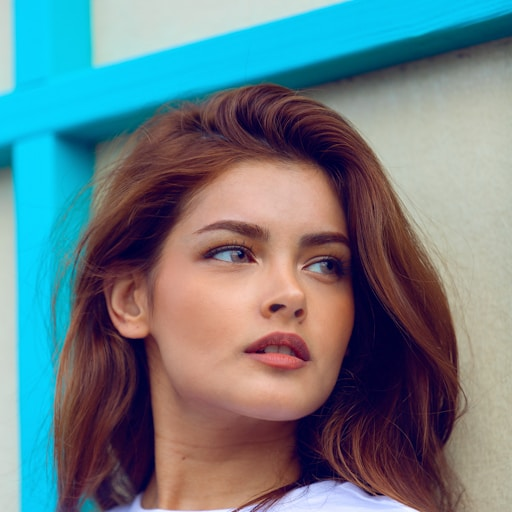

In [7]:
url = "https://images.unsplash.com/photo-1529626455594-4ff0802cfb7e?w=512&h=512&fit=crop"
resp = requests.get(url)
img = PILImage.open(BytesIO(resp.content)).convert("RGB")
path = pathlib.Path("/kaggle/working/sample_face.png")
img.save(path)
FACE_IMG_PATH = str(path)
print("Saved at:", FACE_IMG_PATH)
display(Image(filename=FACE_IMG_PATH))

In [8]:
def describe_person_for_comic(image_path: str) -> str:
    assert image_path and pathlib.Path(image_path).exists(), "Set FACE_IMG_PATH to a valid image path"
    img = PILImage.open(image_path)   # use PILImage here
    prompt = textwrap.dedent("""
        Analyze the photo and return a concise character appearance description for a comic.
        Include hair style/color, eye color, notable features, vibes, and outfit hints.
        Reply in one sentence without naming the person.
    """)
    resp = gclient.models.generate_content(model=MODEL_TEXT, contents=[prompt, img])
    return resp.text.strip()

In [9]:
hero_desc = describe_person_for_comic(FACE_IMG_PATH)
print(hero_desc)

A thoughtful young woman with flowing auburn hair, striking hazel eyes, and a hint of berry lip color wears a casual white top, exuding an effortlessly natural charm.


<a id="7-generate-a-3part-story-json-with-character-guidance"></a>
# <div style="background-color:#577590; color:white; padding:10px; border-radius:10px;">7. 📖 Generate a 3-Part Story (JSON) with Character Guidance</div>
Fill the `characters` list with your cast. Each item can include name, role, personality, powers, and appearance.


In [10]:
def generate_three_part_story(core_prompt: str, characters: list) -> Dict[str, str]:
    characters_block = "\n".join([json.dumps(c, ensure_ascii=False) for c in characters])
    sys_prompt = textwrap.dedent(f"""        You are writing a hopeful climate comic for kids. Create a 3-part story JSON with keys page1, page2, page3.
        Each page: 2-4 sentences, simple, vivid, and include one small, accurate science fact.
        Keep characters consistent with these descriptors:
        {characters_block}
        Core idea: {core_prompt}
        Reply ONLY with JSON: {{"page1":"...","page2":"...","page3":"..."}}
    """)
    resp = gclient.models.generate_content(model=MODEL_TEXT, contents=sys_prompt)
    text = resp.text.strip()
    try:
        data = json.loads(text)
        return {k: data.get(k, "") for k in ["page1", "page2", "page3"]}
    except Exception:
        # Fallback: attempt to extract json block
        import re
        m = re.search(r'\{[\s\S]*\}', text)
        data = json.loads(m.group(0)) if m else {"page1": text, "page2": "", "page3": ""}
        return data

# Example characters
characters = [
    {"name": "Asha", "role": "Hero", "personality": "curious, upbeat", "powers": "robot tinkering", "appearance": "short curly black hair, brown eyes, bright hoodie"},
    {"name": "Bolt", "role": "Sidekick", "personality": "loyal, goofy", "powers": "recycling robot", "appearance": "tiny metal body with green LEDs"},
]
story = generate_three_part_story(core_prompt=suggest_idea(), characters=characters)
story

{'page1': 'Asha, with her bright hoodie and curly black hair, grinned at Bolt, her tiny robot sidekick whose green LEDs blinked happily. They stood beside a pile of tiny tree saplings, ready for a big adventure! Asha explained, "Every tree we plant helps soak up carbon dioxide from the air, making it cleaner for everyone to breathe!" Bolt whirred excitedly, already pointing at the first empty patch of earth.',
 'page2': 'Asha carefully dug a small hole, her brown eyes focused, while Bolt zapped away a stubborn rock with a tiny laser. Other kids joined in, giggling as they gently placed each little sapling into the warm soil. "Roots are super important," Asha explained, "they anchor the tree firmly to the ground and drink up water and nutrients, like straws for the plant!" Bolt then used his little arms to pat the soil around the baby tree.',
 'page3': 'Asha imagined these tiny saplings growing into towering, leafy giants, creating a big, green forest. She knew each one would become a s

<a id="8-create-images"></a>
# <div style="background-color:#277da1; color:white; padding:10px; border-radius:10px;">8. 🎨 Create Images</div>

<a id="a-gemini-image-generation-recommended-for-hackathon"></a>
## <div style="background-color:#277da1; color:white; padding:10px; border-radius:10px;">8.1 🌟 Gemini Image Generation </div>

In [11]:
def extract_images_from_gemini(response) -> List[PILImage.Image]:
    """Extract PIL Images from a Gemini response (interleaved parts)."""
    imgs = []
    for cand in getattr(response, "candidates", []) or []:
        for part in getattr(cand.content, "parts", []) or []:
            if getattr(part, "inline_data", None) and getattr(part.inline_data, "data", None):
                try:
                    img = PILImage.open(BytesIO(part.inline_data.data))
                    imgs.append(img)
                except Exception:
                    pass
    return imgs

def show_and_save(imgs: List[PILImage.Image], basename: str) -> List[str]:
    """Display images and save each to /kaggle/working/; returns file paths."""
    paths = []
    pathlib.Path("/kaggle/working").mkdir(parents=True, exist_ok=True)
    for i, img in enumerate(imgs):
        display(img)
        path = f"/kaggle/working/{basename}_{i+1}.png"
        img.save(path, "PNG")
        paths.append(path)
    return paths

def gen_strip_4panel_gemini(core_prompt: str, characters: list, include_fact: bool = True) -> List[PILImage.Image]:
    characters_text = "; ".join([f"{c.get('name')}: {c.get('appearance','')}" for c in characters])
    fact_line = "Include one short, accurate science fact in a small caption." if include_fact else ""
    prompt = textwrap.dedent(f"""
        Create a SINGLE image formatted as a 4-panel comic strip (2x2 grid) in a 16:9 canvas.
        Panels tell a coherent story about: "{core_prompt}".
        Maintain character consistency across panels: {characters_text}.
        Clean speech bubbles, legible text, high-contrast ink lines, bright kid-friendly color.
        {fact_line}
    """).strip()
    resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[prompt])
    return extract_images_from_gemini(resp)

def gen_pages_4x3_gemini(pages: Dict[str, str]) -> List[PILImage.Image]:
    imgs: List[PILImage.Image] = []
    for i in range(1, 4):
        scene = pages.get(f"page{i}", "")
        prompt = textwrap.dedent(f"""
            Create a full-page comic illustration with clean speech bubbles (no typos) in a 4:3 aspect ratio.
            Scene description: {scene}
            Maintain character consistency from prior descriptions.
        """).strip()
        resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[prompt])
        imgs += extract_images_from_gemini(resp)
        time.sleep(5)  # rate-limit friendly
    return imgs
def apply_comic_style_with_gemini(img: PILImage.Image, style: str = "Manga", line: str = "thick", shading: str = "halftone dots") -> List[PILImage.Image]:
    style_prompt = f"Transform this image to {style} comic style with {line} line work and {shading}. Keep text legible, preserve composition."
    resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[style_prompt, img])
    return extract_images_from_gemini(resp)

def edit_with_gemini(img: PILImage.Image, instruction: str) -> List[PILImage.Image]:
    resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[instruction, img])
    return extract_images_from_gemini(resp)


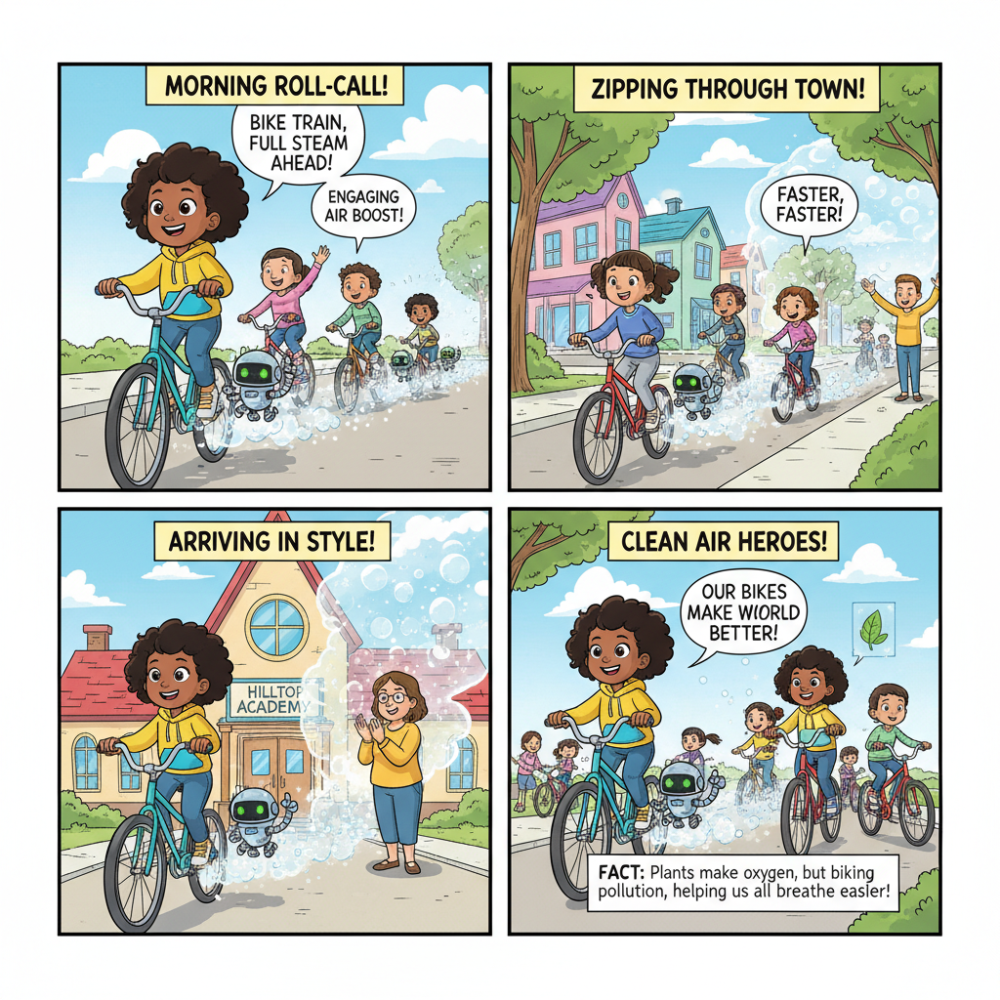

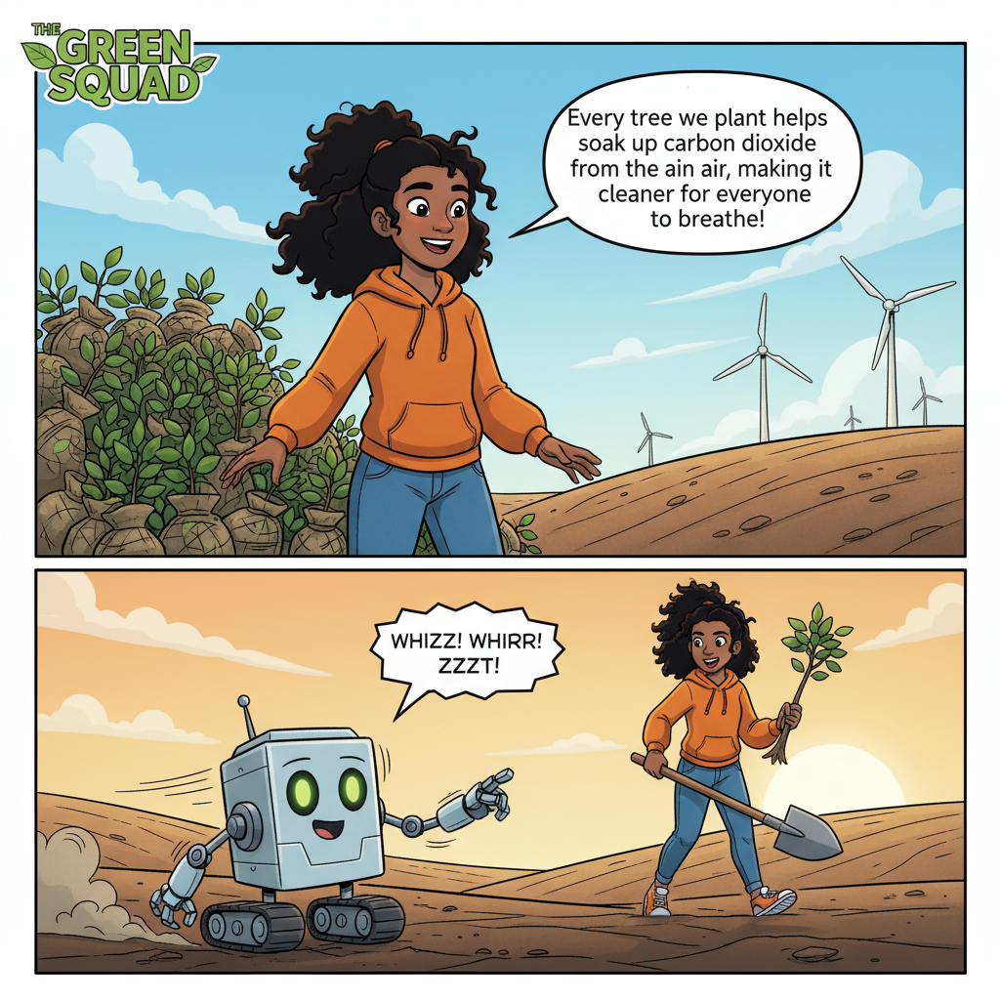

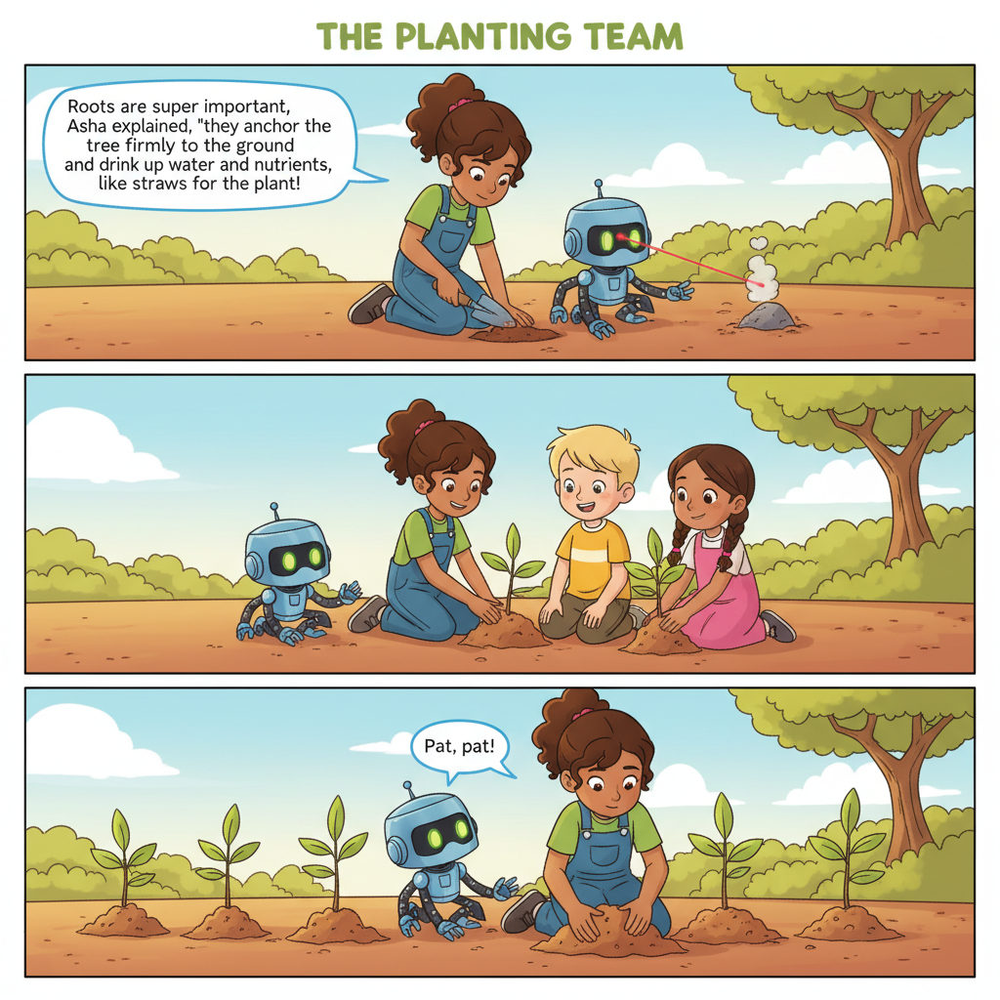

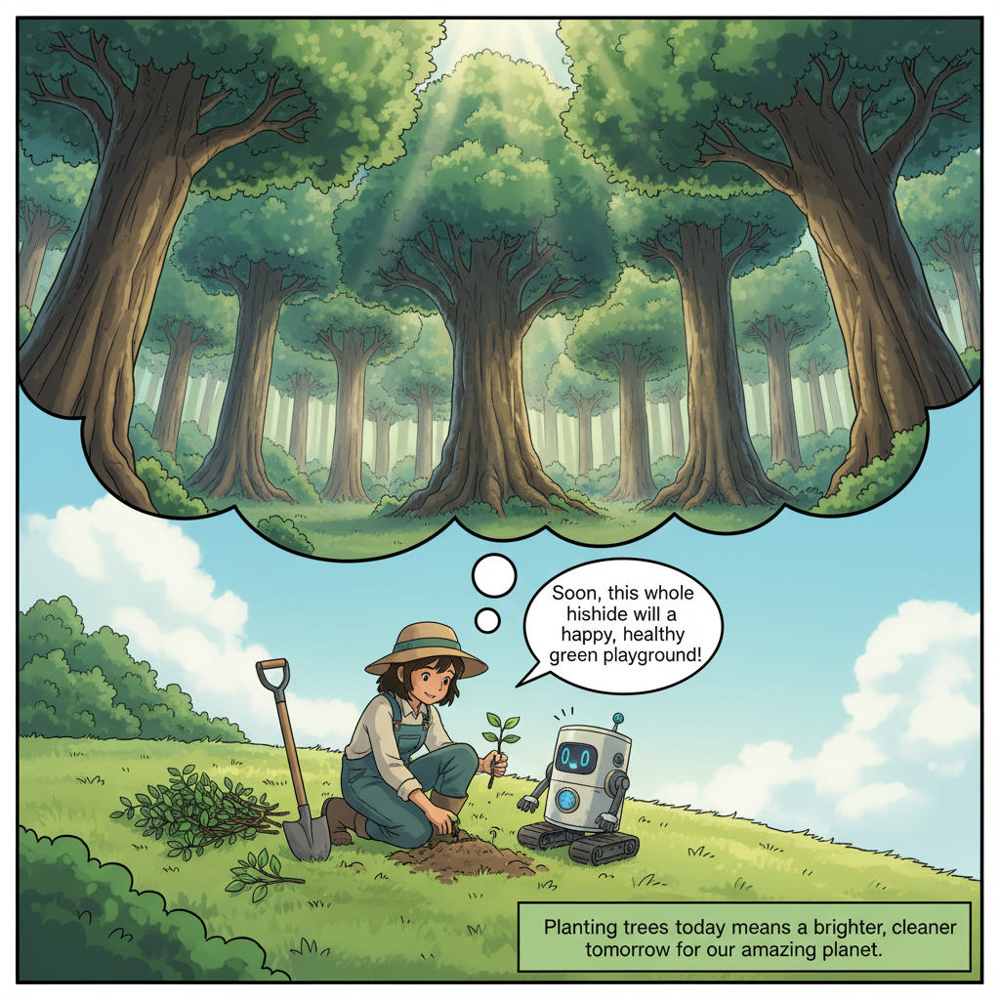

['/kaggle/working/page_1.png',
 '/kaggle/working/page_2.png',
 '/kaggle/working/page_3.png']

In [12]:
strip_imgs = gen_strip_4panel_gemini(core_prompt=suggest_idea(), characters=characters)
show_and_save(strip_imgs, "strip")
page_imgs = gen_pages_4x3_gemini(story)
show_and_save(page_imgs, "page")

<a id="9-apply-comic-book-style-nano-banana-post-process"></a>
# <div style="background-color:#7209b7; color:white; padding:10px; border-radius:10px;">9. 🖼 Apply Comic Book Style (Nano Banana Post-Process)</div>

Transform any base image into a target comic style (e.g., **Manga**, **Western**, line thickness, halftone).


In [13]:
def apply_comic_style_with_gemini(
    img: PILImage.Image,
    style: str = "Manga",
    line: str = "thick",
    shading: str = "halftone dots"
) -> list[PILImage.Image]:
    style_prompt = (
        f"Transform this image to {style} comic style with {line} line work and {shading}. "
        "Keep text legible, preserve composition."
    )
    resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[style_prompt, img])
    return extract_images_from_gemini(resp)

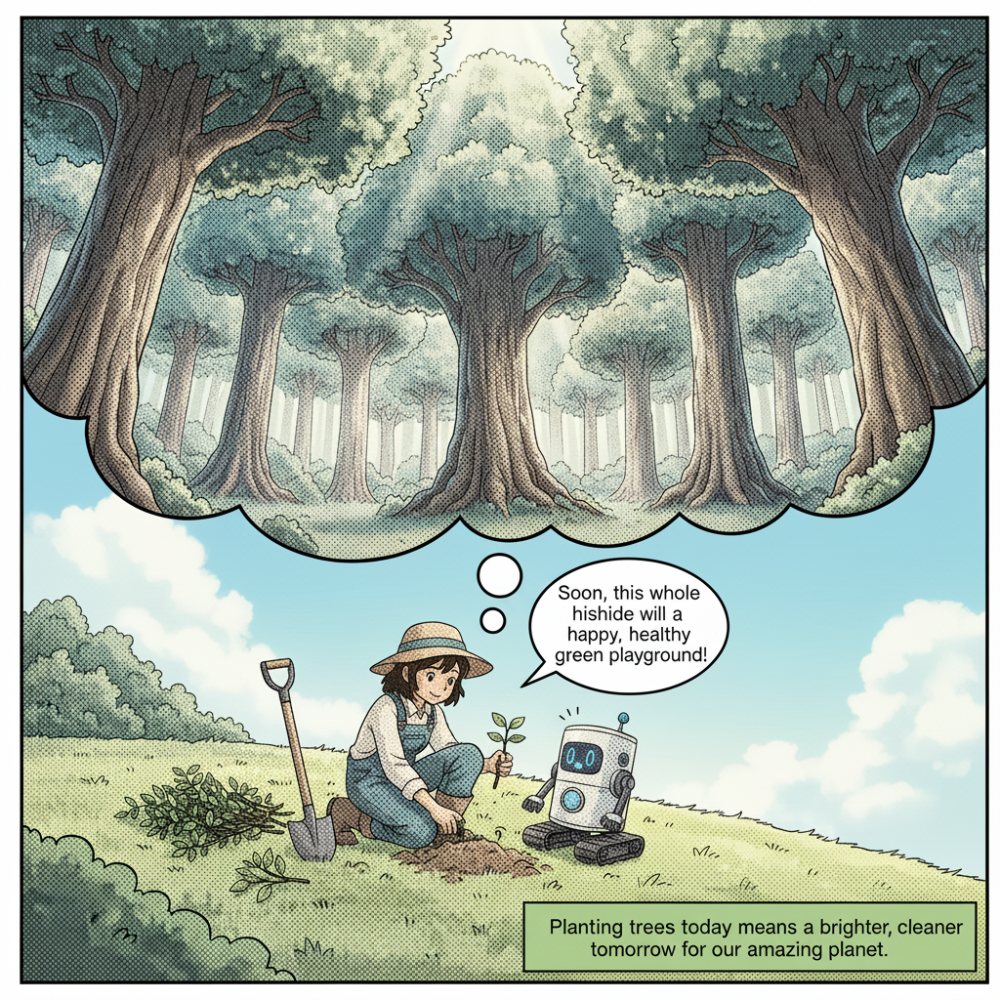

['/kaggle/working/styled_1.png']

In [14]:
base_img = PILImage.open("/kaggle/working/page_3.png")
# Apply the comic style using Nano Banana
stylized = apply_comic_style_with_gemini(
    base_img,
    style="Anime",
    line="thick",
    shading="screentone"
)
show_and_save(stylized, "styled")

<a id="10-edit-your-comic-prompt-based-local-changes"></a>
# <div style="background-color:#560bad; color:white; padding:10px; border-radius:10px;">10. ✏️ Edit Your Comic (Using Nano Banana)</div>

Examples: *"make it night"*, *"add gentle rain"*, *"add a friendly robot watering plants in the background"*.


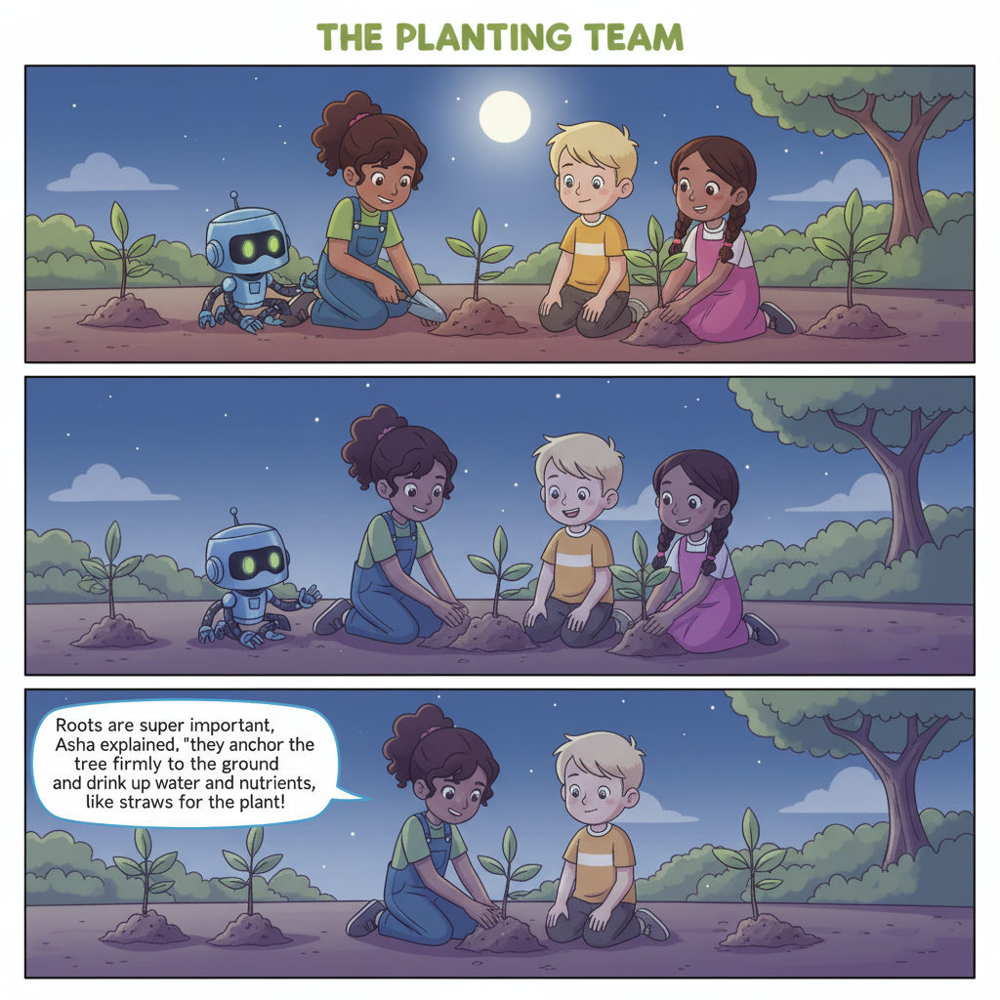

['/kaggle/working/night_1.png']

In [15]:
def edit_with_gemini(img: PILImage.Image, instruction: str) -> list[PILImage.Image]:
    resp = gclient.models.generate_content(model=MODEL_IMAGE, contents=[instruction, img])
    return extract_images_from_gemini(resp)

base_img = PILImage.open("/kaggle/working/page_2.png")
night = edit_with_gemini(base_img, "Turn scene to night with cool moonlight. Keep characters and layout unchanged.")
show_and_save(night, "night")

<a id="11-narrate-a-page-elevenlabs-tts"></a>
# <div style="background-color:#3a0ca3; color:white; padding:10px; border-radius:10px;">11. 🎙 Narrate a Page (ElevenLabs TTS)</div>

Generate MP3 narration for a page's story text.


In [16]:
r = requests.get(
    "https://api.elevenlabs.io/v1/user",
    headers={"xi-api-key": ELEVENLABS_API_KEY}
)
print(r.status_code, r.text[:400])


200 {"user_id":"aYovbf7kKJMdUVsOAyBjhqgpTa33","subscription":{"tier":"free","character_count":0,"character_limit":10000,"max_character_limit_extension":null,"can_extend_character_limit":false,"allowed_to_extend_character_limit":false,"next_character_count_reset_unix":1759813074,"voice_slots_used":0,"professional_voice_slots_used":0,"voice_limit":3,"max_voice_add_edits":54,"voice_add_edit_counter":0,"p


In [17]:
API_KEY = ELEVENLABS_API_KEY
VOICE_ID = "JBFqnCBsd6RMkjVDRZzb"     # replace with your preferred voice
MODEL_ID = "eleven_multilingual_v2"  # or "eleven_turbo_v2_5", "eleven_v3"

In [18]:
def narrate_with_elevenlabs(
    text: str, 
    out_path: str = "/kaggle/working/narration.mp3",
    api_key: str = ELEVENLABS_API_KEY,
    voice_id: str = "your_voice_id_here",  # replace with your ElevenLabs voice ID
    model_id: str = "eleven_multilingual_v1"
) -> str:
    """
    Generate narration for the given text.
    Returns the output file path.
    Falls back to gTTS if ElevenLabs fails.
    """
    try:
        if api_key:
            from elevenlabs import ElevenLabs
            client = ElevenLabs(api_key=api_key)
            stream = client.text_to_speech.convert(
                voice_id=voice_id,
                model_id=model_id,
                text=text,
                output_format="mp3_44100_128",
            )
            # Concatenate audio chunks
            audio_bytes = b"".join(
                chunk if isinstance(chunk, (bytes, bytearray))
                else chunk.read() if hasattr(chunk, "read")
                else bytes(chunk)
                for chunk in stream
            )
            with open(out_path, "wb") as f:
                f.write(audio_bytes)
            display(Audio(out_path))
            print("✅ ElevenLabs TTS succeeded:", out_path)
            return out_path
        else:
            raise ValueError("No ElevenLabs API key provided, falling back to gTTS.")
    except Exception as e:
        print("⚠ ElevenLabs TTS failed:", e)
        try:
            from gtts import gTTS
            tts = gTTS(text=text, lang="en")
            tts.save(out_path)
            display(Audio(out_path))
            print("✅ gTTS succeeded:", out_path)
            return out_path
        except Exception as e2:
            print("❌ gTTS also failed:", e2)
            raise


In [19]:
p1 = narrate_with_elevenlabs(story["page1"], out_path="/kaggle/working/page1.mp3")

⚠ ElevenLabs TTS failed: headers: {'date': 'Sun, 07 Sep 2025 14:58:48 GMT', 'server': 'uvicorn', 'content-length': '111', 'content-type': 'application/json', 'access-control-allow-origin': '*', 'access-control-allow-headers': '*', 'access-control-allow-methods': 'POST, PATCH, OPTIONS, DELETE, GET, PUT', 'access-control-max-age': '600', 'strict-transport-security': 'max-age=31536000; includeSubDomains', 'x-trace-id': '78c8a0b8f546fae7b9dc46e96ed2383d', 'x-region': 'us-central1', 'via': '1.1 google, 1.1 google', 'alt-svc': 'h3=":443"; ma=2592000,h3-29=":443"; ma=2592000'}, status_code: 404, body: {'detail': {'status': 'voice_not_found', 'message': 'A voice with the voice_id your_voice_id_here was not found.'}}


✅ gTTS succeeded: /kaggle/working/page1.mp3


<a id="12-export"></a>
# <div style="background-color:#0077b6; color:white; padding:10px; border-radius:10px;">12. 📤 Export</div>

- **PNG**: saved by previous helpers in `/kaggle/working`  
- **PDF**: `images_to_pdf([...])`  
- **Webcomic (vertical)**: `stitch_vertical([...])`


In [20]:
def show_and_save(imgs: list[PILImage.Image], basename: str) -> list[str]:
    paths = []
    pathlib.Path("/kaggle/working").mkdir(parents=True, exist_ok=True)
    for i, img in enumerate(imgs or []):
        # Coerce to PIL if something odd slipped in
        if not isinstance(img, PILImage.Image):
            raise TypeError(f"Expected PIL.Image, got {type(img)} at index {i}")
        display(img)
        path = f"/kaggle/working/{basename}_{i+1}.png"
        img.save(path, "PNG")
        paths.append(path)
    return paths

def stitch_vertical(images: list[PILImage.Image], padding: int = 10, bg=(255, 255, 255)) -> PILImage.Image:
    if not images:
        raise ValueError("No images provided to stitch_vertical")
    widths = [im.width for im in images]
    max_w = max(widths)
    heights = [im.height for im in images]
    total_h = sum(heights) + padding * (len(images) - 1)

    canvas = PILImage.new("RGB", (max_w, total_h), bg)
    y = 0
    for idx, im in enumerate(images):
        if im.width < max_w:
            im = ImageOps.pad(im, (max_w, im.height), color=bg)
        canvas.paste(im, (0, y))
        y += im.height + (padding if idx < len(images) - 1 else 0)
    return canvas

def images_to_pdf(images: list[PILImage.Image], out_path: str = "/kaggle/working/ecomatrix_story.pdf"):
    if not images:
        raise ValueError("No images provided to images_to_pdf")
    rgb_imgs = [im.convert("RGB") for im in images]
    if len(rgb_imgs) == 1:
        rgb_imgs[0].save(out_path, "PDF")
    else:
        rgb_imgs[0].save(out_path, "PDF", save_all=True, append_images=rgb_imgs[1:])
    return out_path

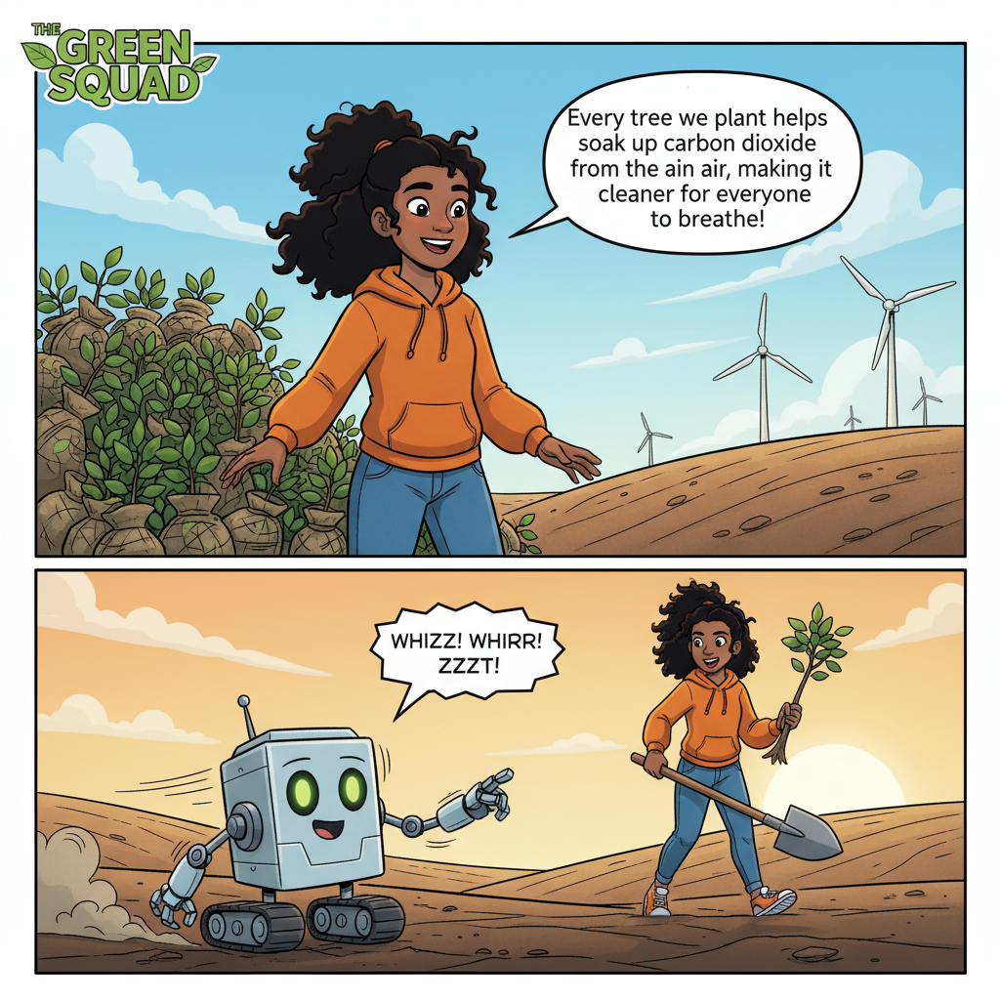

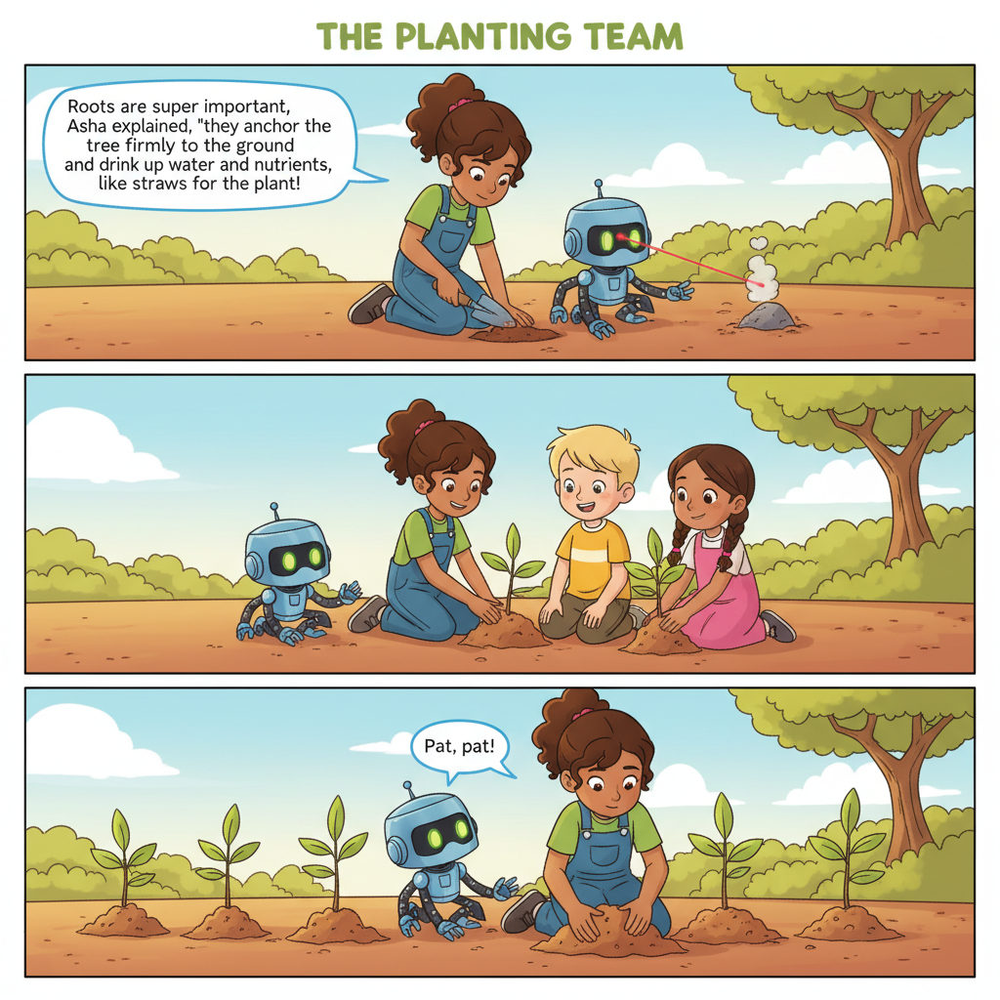

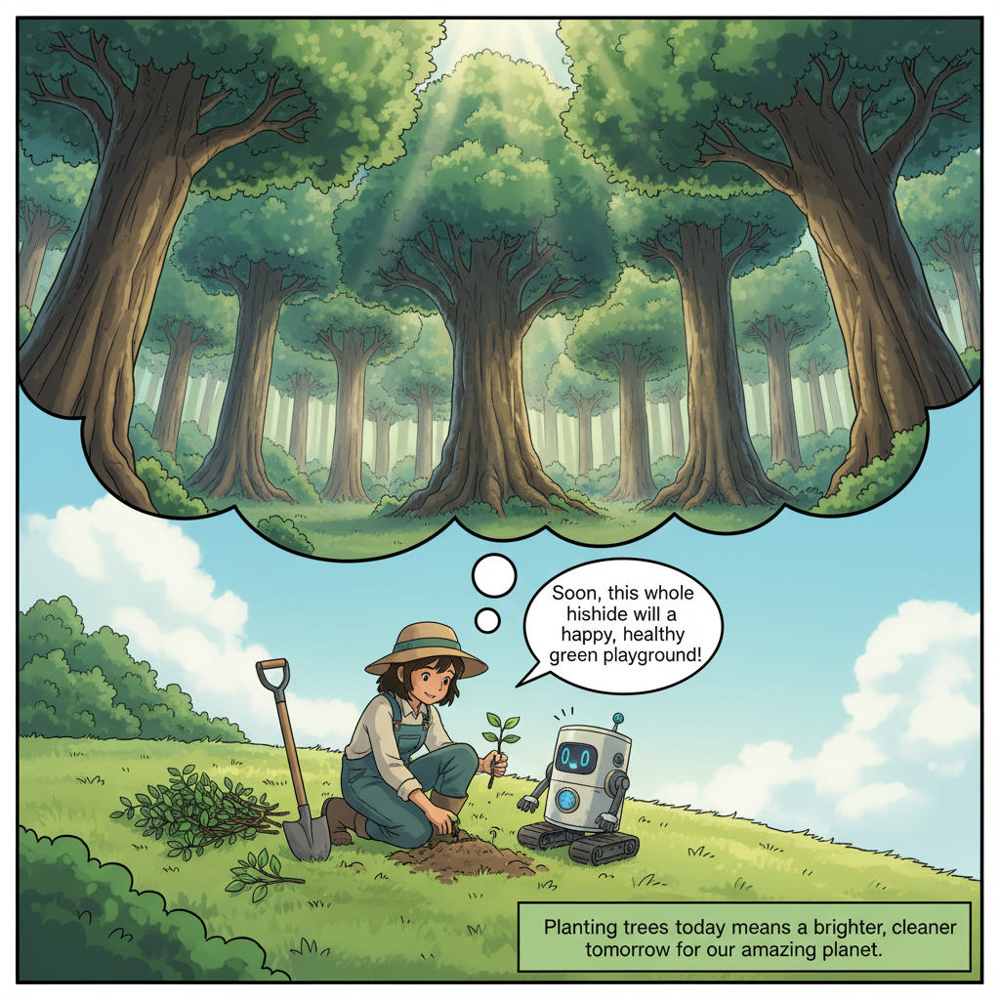

'/kaggle/working/ecomatrix_story.pdf'

In [21]:
saved_paths = show_and_save(page_imgs, "page")
combined = stitch_vertical(page_imgs)
combined.save("/kaggle/working/webcomic_vertical.png", "PNG")
pdf_path = images_to_pdf(page_imgs, "/kaggle/working/ecomatrix_story.pdf")
pdf_path

<a id="13-endtoend-quick-demo"></a>
# <div style="background-color:#0096c7; color:white; padding:10px; border-radius:10px;">13. 🚀 End-to-End Quick Demo</div>
This ties it all together:
1) Idea → 3‑part story  
2) 3 images (Gemini)  
3) Optional style pass (Nano Banana)  
4) Narrate page 1 (ElevenLabs)  
5) Export


IDEA: Kids grin as they transform old plastic bottles into whimsical watering cans and colorful plant markers, giving their garden a happy boost and plastic a new purpose!
PAGE1: Asha, with her bright hoodie and curly hair, and Bolt, her tiny robot pal with glowing green LEDs, spotted a pile of plastic bottles. 'These used to hold drinks, but now they're just... waiting,' Asha mused, looking thoughtful. Bolt bleeped, as if agreeing. Did you know most plastic is made from oil and gas, which are fossil fuels dug up from deep underground? Asha grinned, 'Let's give them a new purpose!'


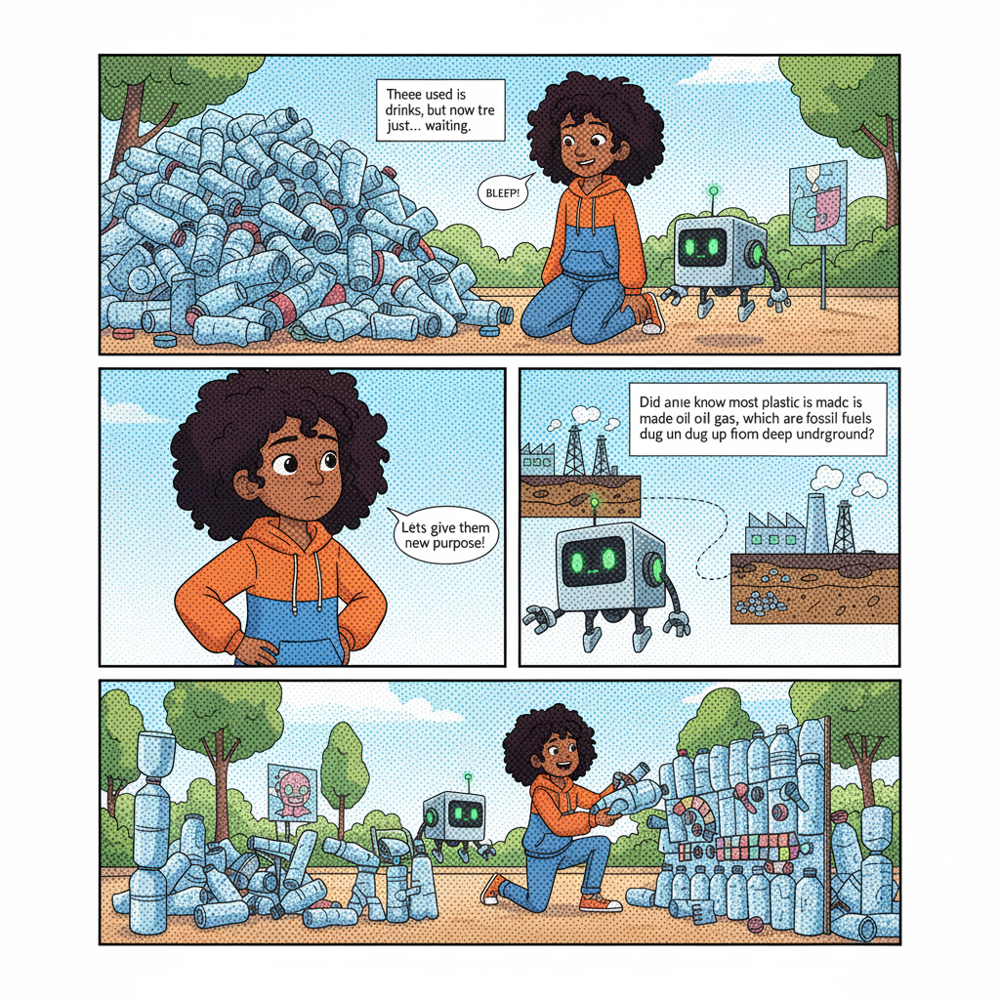

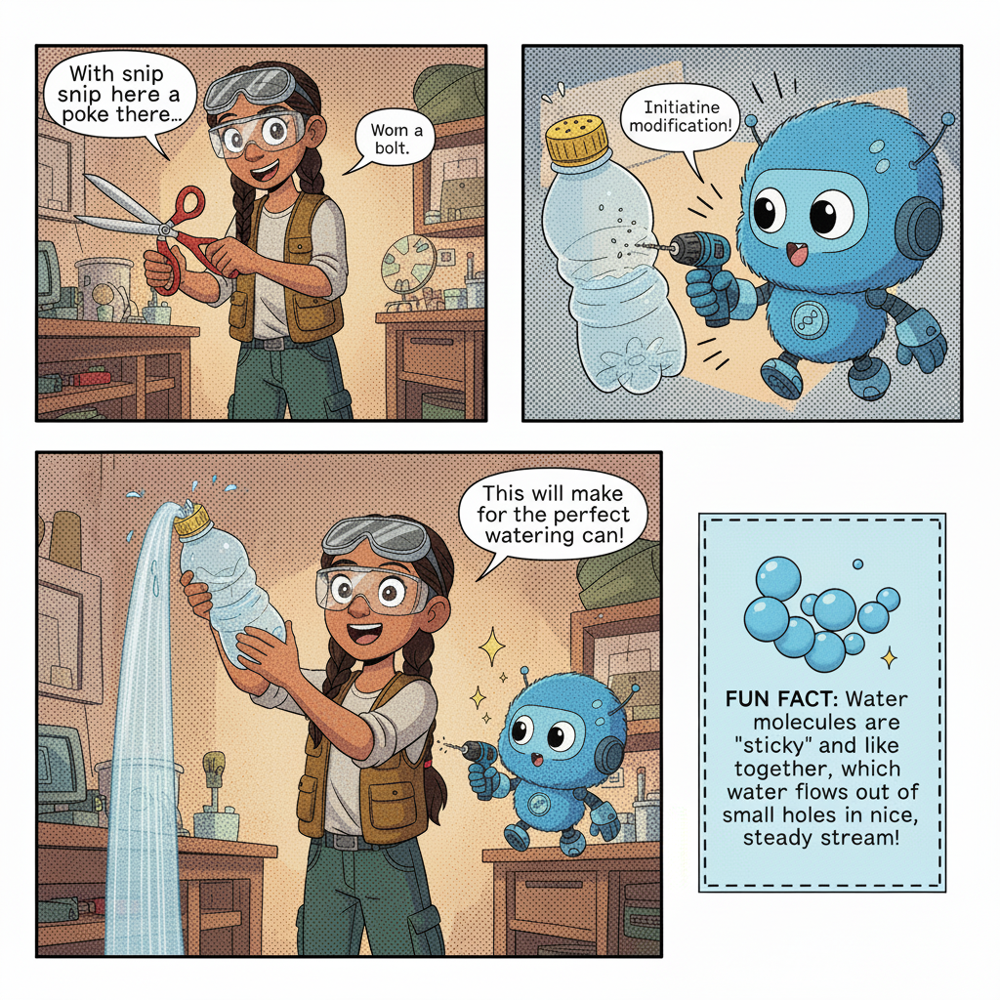

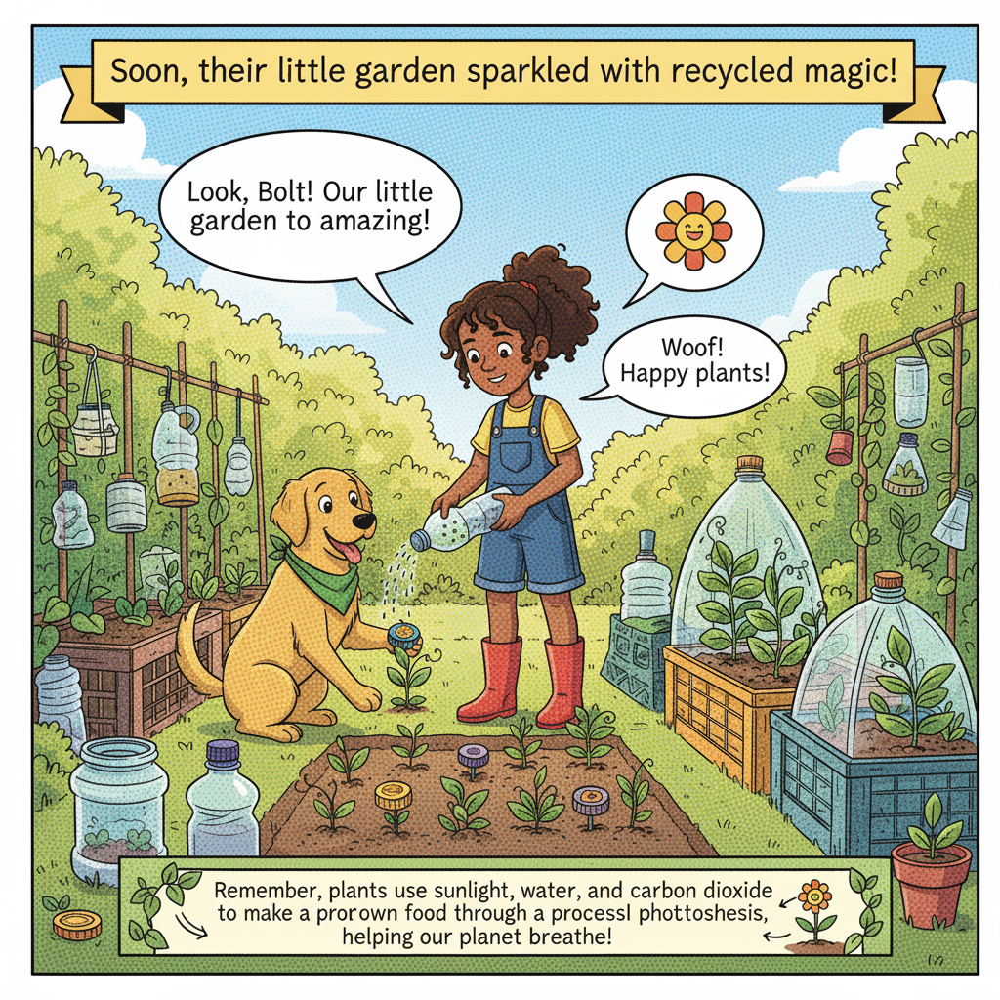

⚠ ElevenLabs TTS failed: headers: {'date': 'Sun, 07 Sep 2025 15:00:33 GMT', 'server': 'uvicorn', 'content-length': '111', 'content-type': 'application/json', 'access-control-allow-origin': '*', 'access-control-allow-headers': '*', 'access-control-allow-methods': 'POST, PATCH, OPTIONS, DELETE, GET, PUT', 'access-control-max-age': '600', 'strict-transport-security': 'max-age=31536000; includeSubDomains', 'x-trace-id': 'b1c7289c64558a116b48e49e9da184fc', 'x-region': 'us-central1', 'via': '1.1 google, 1.1 google', 'alt-svc': 'h3=":443"; ma=2592000,h3-29=":443"; ma=2592000'}, status_code: 404, body: {'detail': {'status': 'voice_not_found', 'message': 'A voice with the voice_id your_voice_id_here was not found.'}}


✅ gTTS succeeded: /kaggle/working/narration.mp3


'/kaggle/working/ecomatrix_story.pdf'

In [22]:
idea = suggest_idea("kids upcycling plastic into garden gadgets")
chars = [
    {"name":"Asha","role":"Hero","appearance":"short curly black hair, brown eyes, bright hoodie"},
    {"name":"Bolt","role":"Sidekick","appearance":"tiny recycling robot with green LEDs"},
]
story = generate_three_part_story(idea, chars)
print("IDEA:", idea)
print("PAGE1:", story["page1"])
gen_source = "gemini"
# Generate images
imgs = []
if gen_source == "gemini":
    imgs = gen_pages_4x3_gemini(story)
styled = []
for im in imgs:
    out = apply_comic_style_with_gemini(im, style="Manga", line="thick", shading="halftone dots")
    styled.append(out[0] if out else im)
    time.sleep(2)
show_and_save(styled, "story_page")
narrate_with_elevenlabs(story["page1"])
combined = stitch_vertical(styled)
combined.save("/kaggle/working/webcomic_vertical.png", "PNG")
images_to_pdf(styled, "/kaggle/working/ecomatrix_story.pdf")

<a id="14-notes--limits"></a>
# <div style="background-color:#00b4d8; color:white; padding:10px; border-radius:10px;">14. 📋 Notes & Limits</div>
- Respect hackathon **quota**: 20 images/min, 200 req/day per free key. Insert `time.sleep()` between loops.
- **Ethics**: Avoid deceptive or harmful edits. Gemini adds **SynthID** watermark to edited images.
- **Attribution**: Cite Gemini, ElevenLabs, and fal.ai in your writeup.  
- **Public demo**: Host on AI Studio App or a minimal Streamlit/Gradio, or share this Kaggle Notebook link.


<a id="appendix--gemini-integration-200-words-draft"></a>
# <div style="background-color:#006d77; color:white; padding:10px; border-radius:10px;">📎 Appendix — Gemini Integration</div>
**EcoMatrix** harnesses the dynamic creation capabilities of **Gemini 2.5 Flash Image ("Nano Banana")**, putting users directly in the **director's chair**.  

### Edit with Words  
The **"Edit with words"** feature is fundamental to the app's workflow, empowering users to **iteratively refine comic pages using natural language**.  
- Example: A user can type **"add a friendly sun wearing sunglasses"**  
- Or apply quick ambiance effects like **"make the scene rainy"**  

Nano Banana then **intelligently modifies the artwork**, bringing the description to life.  
This same **inpainting and editing power** is also used to apply the **initial comic book styling**, transforming generated images into a specific **artistic vision**.  

### User-as-Hero — Blending Realities  
The app also **"blends realities"** with its innovative **User-as-Hero** feature:  
- Powered by **Gemini’s multimodal understanding**  
- Analyzes an uploaded **photo**  
- Generates a **detailed character description** based on the user’s likeness  

This creates a **seamless integration of the real world** into the comic's narrative.  

### Why It Matters  
These core features —  
- **Image editing via text**  
- **Visual analysis for personalization**  

make **Nano Banana indispensable**, transforming **EcoMatrix** from a **static generator** into an **interactive storytelling canvas** where users can **dynamically shape their vision**.  


## Next Steps  

### Potential Improvements  
- **Enhanced Styling Options:** Allow finer control over art style (e.g., brush stroke thickness, color palettes, shading presets).  
- **Better Panel Layouts:** Move beyond 4-panel strips and 3-page stories to flexible layouts (grid-based, vertical scroll, dynamic panel resizing).  
- **Improved Onboarding:** Add contextual tooltips or mini-demos for new features beyond the initial tutorial.  

### Refactoring Ideas  
- **Modularize the Workflow:** Break down generation, styling, and editing into more reusable components for easier maintenance.  
- **State Management Upgrade:** Consider integrating Zustand or Redux Toolkit for more scalable state handling instead of relying only on `localStorage`.  
- **API Call Optimization:** Introduce batching or caching for repeated prompts to reduce redundant Gemini API requests.  

### Future Experiments  
- **Collaborative Storytelling:** Enable multiple users to co-create comics in real time.  
- **Adaptive Narration:** Use expressive voices or emotional tones in text-to-speech narration to better match the story’s mood.  
- **Augmented Reality (AR) Output:** Experiment with exporting characters or scenes as AR objects.  
- **Feedback Loop with Users:** Let readers “vote” or “branch” storylines, creating interactive or evolving climate comics.  
- **Integration with Social Platforms:** Auto-generate shareable short-form content (Instagram stories, TikTok reels) directly from comics.  


## Citation
\[@eco-matrix-2025]

**Citation**: Logan Kilpatrick, Omar Sanseviero, Paige Bailey, Amit Vadi, Lauren Usui, Lloyd Hightower, Philipp Schmid, Patrick Löber, Guillaume Vernade, Ammaar Reshi, Natalie Dao, M.E. Francis, Harrison Jobe, JD Choi, Vishal Dharmadhikari, Pradeep Kuppala, Christina Warren, Alisa Fortin, Meg Risdal, and Addison Howard. *NanoBanana Hackathon & EcoMatrix Comic Generator*. Kaggle. [Kaggle](https://kaggle.com/competitions/banana), 2025.


<div align="center" style="background-color: #C4E1F6; padding: 20px; border-radius: 10px;">
  <h1 style="color: blue;">Thank You 🙇‍♂️ for Visiting My Notebook!</h1>

  <p style="font-size: 18px; color: black;">
    <br>Your feedback is greatly appreciated and motivates me to continue developing more valuable and informative notebooks
  </p>
</div>